<a href="https://colab.research.google.com/github/AntsaHoneywinner/DSI/blob/main/Twist_Challenge_Antsa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DSI Program  Twist Challenge!

Antsa Tantely Fandresena RAKOTONDRAFARA



On GitHub https://github.com/AntsaHoneywinner/DSI/blob/main/Twist_Challenge_Antsa.ipynb


**Concerned problem :** Classifying image of happy girls and unhappy girls. 


**Why ?** I am planning to create an NGO to assist girls to finish their studies. So the main goal here is to identify unhappy girls and approach them.


I am more okay with false positive than with false negative because I do not want to miss any unhappy girl. As if I have a false positive, approach that girl and assist her, that will still be helpful for her.


**Data set used** I used images from https://unsplash.com/s/photos/sad-girl and https://unsplash.com/s/photos/happy-girl

**Pretrained model used :** VGG16 (I read about it from many blogs so I trusted them and their results)



https://www.codeproject.com/Articles/5275262/AI-Face-Recognition-with-a-Pre-Trained-Model




Build a GUI that can demo your classifier in real time on new images


## Data preparation

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
root_path = '/content/gdrive/MyDrive'

In [21]:
# This code was used to unzip the data folder so after I unzip, I will comment them all


#importing the needed library

import pandas as pd
import zipfile
from google.colab import files
import io
import os
from os import makedirs
from os import listdir
from shutil import copyfile
from random import seed
from random import random
from PIL import Image

import keras,os
from keras.models import Sequential
from keras.layers import Dense, Conv2D, MaxPool2D , Flatten
from keras.preprocessing.image import ImageDataGenerator
import numpy as np
import cv2


In [142]:
import tensorflow as tf
print("TensorFlow version:", tf.__version__)

from tensorflow.keras.layers import Dense, Flatten, Conv2D
from tensorflow.keras import Model

TensorFlow version: 2.7.0


In [ ]:
ls /content/gdrive/MyDrive/Happy_vs_sad

happy.0.jpg   happy.16.jpg  happy.4.jpg  sad.10.jpg  sad.17.jpg  sad.5.jpg
happy.10.jpg  happy.17.jpg  happy.5.jpg  sad.11.jpg  sad.18.jpg  sad.6.jpg
happy.11.jpg  happy.18.jpg  happy.6.jpg  sad.12.jpg  sad.19.jpg  sad.7.jpg
happy.12.jpg  happy.19.jpg  happy.7.jpg  sad.13.jpg  sad.1.jpg   sad.8.jpg
happy.13.jpg  happy.1.jpg   happy.8.jpg  sad.14.jpg  sad.2.jpg   sad.9.jpg
happy.14.jpg  happy.2.jpg   happy.9.jpg  sad.15.jpg  sad.3.jpg
happy.15.jpg  happy.3.jpg   sad.0.jpg    sad.16.jpg  sad.4.jpg


## Vizualizing the image data

https://machinelearningmastery.com/how-to-develop-a-convolutional-neural-network-to-classify-photos-of-dogs-and-cats/

In [ ]:
folder = 'gdrive/MyDrive/dogs-vs-cats/train/train/'


In [ ]:
ls /content/gdrive/MyDrive/Happy_vs_sad

happy.0.jpg   happy.16.jpg  happy.4.jpg  sad.10.jpg  sad.17.jpg  sad.5.jpg
happy.10.jpg  happy.17.jpg  happy.5.jpg  sad.11.jpg  sad.18.jpg  sad.6.jpg
happy.11.jpg  happy.18.jpg  happy.6.jpg  sad.12.jpg  sad.19.jpg  sad.7.jpg
happy.12.jpg  happy.19.jpg  happy.7.jpg  sad.13.jpg  sad.1.jpg   sad.8.jpg
happy.13.jpg  happy.1.jpg   happy.8.jpg  sad.14.jpg  sad.2.jpg   sad.9.jpg
happy.14.jpg  happy.2.jpg   happy.9.jpg  sad.15.jpg  sad.3.jpg
happy.15.jpg  happy.3.jpg   sad.0.jpg    sad.16.jpg  sad.4.jpg


In [ ]:
folder1 = '/content/gdrive/MyDrive/Happy_vs_sad'

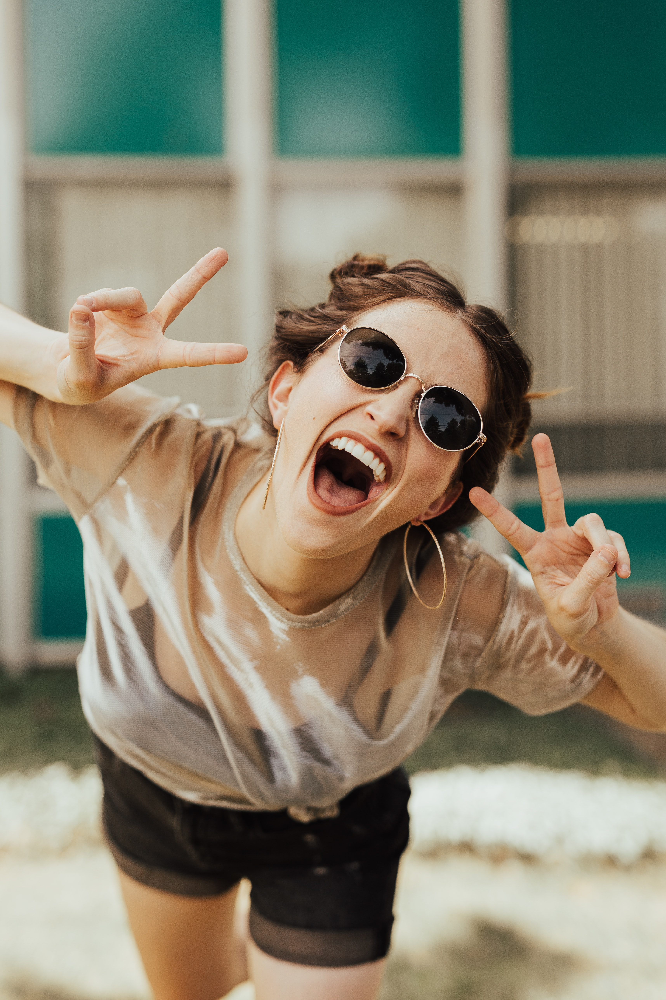

In [ ]:
display(Image.open(folder1+'/happy.0.jpg'))

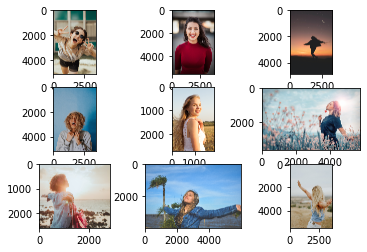

In [ ]:
# plot photo
from matplotlib import pyplot
from matplotlib.image import imread
# define location of dataset
# plot first few images
for i in range(9):
	# define subplot
	pyplot.subplot(330 + 1 + i)
	# define filename
	filename = folder1 + '/happy.' + str(i) + '.jpg'
	# load image pixels
	image = imread(filename)
	# plot raw pixel data
	pyplot.imshow(image)
# show the figure
pyplot.show()

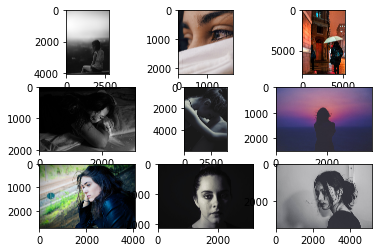

In [ ]:
# plot dog photos from the dogs vs cats dataset
from matplotlib import pyplot
from matplotlib.image import imread
# define location of dataset
# plot first few images
for i in range(9):
	# define subplot
	pyplot.subplot(330 + 1 + i)
	# define filename
	filename = folder1 + '/sad.' + str(i) + '.jpg'
	# load image pixels
	image = imread(filename)
	# plot raw pixel data
	pyplot.imshow(image)
# show the figure
pyplot.show()

## Splitting data into train and test and create label

In [32]:
import glob


In [35]:
pic_list = glob.glob(folder1+"/*.jpg")

In [ ]:
pic_list

In [42]:
import random
random.shuffle(pic_list)


In [ ]:
pic_list

In [93]:
def classify(picture) :
  if 'sad/happy' in picture :
    return(1)#happy
  else:
    return(0)#sad

In [45]:
classify('/content/gdrive/MyDrive/Happy_vs_sad/sad.7.jpg')

'sad'

In [94]:
mydata_data = pd.DataFrame({'pic_name' : pic_list, 'label' : [classify(i) for i in pic_list] })

In [134]:
X = []
for i in pic_list:
  X.append(cv2.resize(cv2.imread(i), (224, 224)))

In [132]:
Y = list(mydata_data['label'])

In [135]:
X, Y = np.array(X), np.array(Y)

In [90]:
from keras.utils import np_utils


In [136]:
classes = np.unique(Y)
nClasses = len(classes)
print('Total number of outputs : ', nClasses)
print('Output classes : ', classes)
Y = np_utils.to_categorical(Y, nClasses)

Total number of outputs :  2
Output classes :  [0 1]


In [100]:
from sklearn.model_selection import train_test_split

In [137]:
X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=.2, shuffle=0)
X_train, X_test, Y_train, Y_test = train_test_split(X_train, Y_train, test_size=.3, shuffle=0)

In [138]:
print('Training data shape : ', X_train.shape, Y_train.shape)
print('Validation data shape : ', X_val.shape, Y_val.shape)
print('Testing data shape : ', X_test.shape, Y_test.shape)

Training data shape :  (22, 224, 224, 3) (22, 2)
Validation data shape :  (8, 224, 224, 3) (8, 2)
Testing data shape :  (10, 224, 224, 3) (10, 2)


## Model initialization

In [111]:
from keras.applications.vgg16 import VGG16
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input
from keras.layers import Input, Flatten, Dense
from keras.models import Model

In [128]:
from keras.applications.vgg16 import VGG16
# load the model
model = VGG16()

553476096/553467096 [==============================] - 4s 0us/step


In [139]:
model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [143]:
tf.config.run_functions_eagerly(True)

In [144]:
history = my_model.fit(X_train, Y_train, epochs=4, verbose=1)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:4527: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


Epoch 1/4
1/1 [==============================] - 50s 50s/step - loss: 9981.5684 - accuracy: 0.5455
Epoch 2/4
1/1 [==============================] - 46s 46s/step - loss: 4.0326 - accuracy: 0.4545
Epoch 3/4
1/1 [==============================] - 43s 43s/step - loss: 0.7665 - accuracy: 0.4545
Epoch 4/4
1/1 [==============================] - 44s 44s/step - loss: 0.6746 - accuracy: 0.5455


In [158]:
prediction_classes_train = my_model.predict(X_train)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:4527: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


In [159]:
prediction_classes_train

array([[0.1354606 , 0.86453944],
       [0.03341567, 0.96658427],
       [0.09373583, 0.9062642 ],
       [0.02068024, 0.97931975],
       [0.02446174, 0.9755383 ],
       [0.04018876, 0.9598112 ],
       [0.08211472, 0.9178853 ],
       [0.03615111, 0.9638489 ],
       [0.0495113 , 0.9504887 ],
       [0.13199197, 0.8680081 ],
       [0.04268325, 0.95731676],
       [0.06478672, 0.9352133 ],
       [0.09892618, 0.9010738 ],
       [0.0862372 , 0.91376275],
       [0.14946671, 0.85053325],
       [0.22024927, 0.7797507 ],
       [0.06291351, 0.93708646],
       [0.13297066, 0.86702937],
       [0.0997879 , 0.90021217],
       [0.04941152, 0.9505885 ],
       [0.06572733, 0.93427265],
       [0.03693958, 0.96306044]], dtype=float32)

In [154]:
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import confusion_matrix


In [156]:
confusion_matrix(np.argmax(Y_train,1), prediction_classes_train)

ValueError: ignored